In [1]:
# basic packages
import pandas as pd
import numpy as np

# viz
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib_venn import venn2
import plotly.express as px

In [ ]:
#sentence & length count (seperately by QA & MD) >> in the model nb
#Participants internally and externally
#Number of companies in each groups sectors (region?)
#Sentiment score (interavtive wirth groups and time) (stock price?)
Topics (cor score, topic clusters) (time series?)

## Import data

In [2]:
# Management Discussion 
md_df = pd.read_csv("/Users/siradachuntararuangnapa/Desktop/main_df_output/topic_modelling_df_MD22.csv")
# Q&A
qa_df = pd.read_csv("/Users/siradachuntararuangnapa/Desktop/main_df_output/topic_modelling_df_QA8.csv")

## Sentence & Length Count

In [ ]:
'word_count',
 'char_count',
 'sentence_count',
 'avg_word_length',
 'avg_sentence_length',

In [134]:
# Create df with selected information for 'sentence_count', 'word_count', 'avg_word_length', 'avg_sentence_length', 'date'
md_sen_count = md_df[['sentence_count', 'word_count', 'avg_word_length', 'avg_sentence_length', 'date']].copy()
md_sen_count.rename(columns={'sentence_count': 'md_sentence_count', 'word_count' : 'md_word_count', 'avg_word_length': 'md_avg_word_length', 'avg_sentence_length':'md_avg_sentence_length'}, inplace=True)
qa_sen_count = qa_df[['sentence_count', 'word_count', 'avg_word_length', 'avg_sentence_length', 'date']].copy()
qa_sen_count.rename(columns={'sentence_count': 'qa_sentence_count', 'word_count' : 'qa_word_count', 'avg_word_length': 'qa_avg_word_length', 'avg_sentence_length':'qa_avg_sentence_length'}, inplace=True)

In [135]:
#merge
merge_sen_count = md_sen_count.append(qa_sen_count)
merge_sen_count

/var/folders/k8/lb3hjpyj2sz2hb72z52wqt_80000gn/T/ipykernel_2951/3529423250.py:1: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,md_sentence_count,md_word_count,md_avg_word_length,md_avg_sentence_length,date,qa_sentence_count,qa_word_count,qa_avg_word_length,qa_avg_sentence_length
0,7.0,5.0,8.600000,0.714286,2011-02-02,NaN,NaN,NaN,NaN
1,5.0,12.0,6.250000,2.400000,2011-02-02,NaN,NaN,NaN,NaN
2,36.0,70.0,6.885714,1.944444,2011-02-02,NaN,NaN,NaN,NaN
3,7.0,22.0,7.500000,3.142857,2011-02-02,NaN,NaN,NaN,NaN
4,11.0,12.0,6.000000,1.090909,2011-02-02,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
60544,NaN,NaN,NaN,NaN,2022-04-27,5.0,1.0,8.000000,0.200000
60545,NaN,NaN,NaN,NaN,2022-04-27,10.0,27.0,6.962963,2.700000
60546,NaN,NaN,NaN,NaN,2022-04-27,13.0,41.0,5.463415,3.153846
60547,NaN,NaN,NaN,NaN,2022-04-27,5.0,1.0,7.000000,0.200000


In [138]:
# plot1: MD and Q&A Sentence Count
df = merge_sen_count
fig = px.histogram(merge_sen_count, x="date", y=["md_sentence_count", 'qa_sentence_count'], marginal="rug", title= 'Histogram: Management Discussion and Q&A Sentence Count')
fig.show()

In [142]:
# plot2: MD and Q&A Avg Sentence Length
df = merge_sen_count
fig = px.histogram(merge_sen_count, x="date", y=['md_avg_sentence_length', 'qa_avg_sentence_length'], marginal="rug", title= 'Histogram: Management Discussion and Q&A Avg Sentence Length')
fig.show()

In [144]:
# plot3: MD and Q&A Word Count
df = merge_sen_count
fig = px.histogram(merge_sen_count, x="date", y=['md_word_count', 'qa_word_count'], marginal="rug", title= 'Histogram: Management Discussion and Q&A Word Count')
fig.show()

In [145]:
# plot4: MD and Q&A Avg Word Length 
df = merge_sen_count
fig = px.histogram(merge_sen_count, x="date", y=['md_avg_word_length', 'qa_avg_word_length'], marginal="rug", title= 'Histogram: Management Discussion and Q&A Avg Word Length')
fig.show()

## Participants Count

#### MD

In [7]:
md_par_df = md_df.groupby(["company_name", "company_paticipants_yes","other_paticipants_yes"]).size().reset_index(name="par_time")
md_par_df.rename(columns={'company_paticipants_yes': 'md_company_par_yes', 'other_paticipants_yes': 'md_other_par_yes'}, inplace=True)
md_par_df

,company_name,md_company_par_yes,md_other_par_yes,par_time
0,AMERICAN INTERNA-,0,1,90
1,AMERICAN INTERNA-,1,0,531
2,AMERICAN INTERNA-,1,1,74
3,ARCH CAPITAL,0,1,85
4,ARCH CAPITAL,1,0,420
...,...,...,...,...
190,Tryg A-S-,1,0,310
191,Tryg A-S-,1,1,62
192,ZURICH INSURANCE-,0,1,58
193,ZURICH INSURANCE-,1,0,172


In [8]:
md_par_df.loc[
       (md_par_df['md_company_par_yes'] == 0) & 
       (md_par_df['md_other_par_yes'] == 1),
       'par_type'] = 'md_other_par'

md_par_df.loc[
       (md_par_df['md_company_par_yes'] == 1) & 
       (md_par_df['md_other_par_yes'] == 0),
       'par_type'] = 'md_com_par'

md_par_df.loc[
       (md_par_df['md_company_par_yes'] == 1) & 
       (md_par_df['md_other_par_yes'] == 1),
       'par_type'] = 'md_both'

md_par_df

,company_name,md_company_par_yes,md_other_par_yes,par_time,par_type
0,AMERICAN INTERNA-,0,1,90,md_other_par
1,AMERICAN INTERNA-,1,0,531,md_com_par
2,AMERICAN INTERNA-,1,1,74,md_both
3,ARCH CAPITAL,0,1,85,md_other_par
4,ARCH CAPITAL,1,0,420,md_com_par
...,...,...,...,...,...
190,Tryg A-S-,1,0,310,md_com_par
191,Tryg A-S-,1,1,62,md_both
192,ZURICH INSURANCE-,0,1,58,md_other_par
193,ZURICH INSURANCE-,1,0,172,md_com_par


In [26]:
df = md_par_df
fig = px.histogram(md_par_df, x='md_company_par_yes', y="par_time",
             color='par_type',
             height=500, title = 'Bar: Management Discussion Participant Types')
fig.show()

In [27]:
df = md_par_df
fig = px.pie(md_par_df, values='par_time', names='par_type', title='Pie: Management Discussion Participant Types')
fig.show()

#### Q&A

In [9]:
qa_par_df = qa_df.groupby(["company_name", "company_paticipants_yes","other_paticipants_yes"]).size().reset_index(name="par_time")
qa_par_df.rename(columns={'company_paticipants_yes': 'qa_company_par_yes', 'other_paticipants_yes': 'qa_other_par_yes'}, inplace=True)
qa_par_df

,company_name,qa_company_par_yes,qa_other_par_yes,par_time
0,AMERICAN INTERNA-,0,1,150
1,AMERICAN INTERNA-,1,0,891
2,AMERICAN INTERNA-,1,1,130
3,ARCH CAPITAL,0,1,303
4,ARCH CAPITAL,1,0,1147
...,...,...,...,...
192,Tryg A-S-,1,0,1047
193,Tryg A-S-,1,1,191
194,ZURICH INSURANCE-,0,1,574
195,ZURICH INSURANCE-,1,0,1026


In [10]:
qa_par_df.loc[
       (qa_par_df['qa_company_par_yes'] == 0) & 
       (qa_par_df['qa_other_par_yes'] == 1),
       'par_type'] = 'qa_other_par'

qa_par_df.loc[
       (qa_par_df['qa_company_par_yes'] == 1) & 
       (qa_par_df['qa_other_par_yes'] == 0),
       'par_type'] = 'qa_com_par'

qa_par_df.loc[
       (qa_par_df['qa_company_par_yes'] == 1) & 
       (qa_par_df['qa_other_par_yes'] == 1),
       'par_type'] = 'qa_both'

qa_par_df

,company_name,qa_company_par_yes,qa_other_par_yes,par_time,par_type
0,AMERICAN INTERNA-,0,1,150,qa_other_par
1,AMERICAN INTERNA-,1,0,891,qa_com_par
2,AMERICAN INTERNA-,1,1,130,qa_both
3,ARCH CAPITAL,0,1,303,qa_other_par
4,ARCH CAPITAL,1,0,1147,qa_com_par
...,...,...,...,...,...
192,Tryg A-S-,1,0,1047,qa_com_par
193,Tryg A-S-,1,1,191,qa_both
194,ZURICH INSURANCE-,0,1,574,qa_other_par
195,ZURICH INSURANCE-,1,0,1026,qa_com_par


In [28]:
df = qa_par_df
fig = px.histogram(qa_par_df, x='qa_company_par_yes', y="par_time",
             color='par_type',
             height=500, title = 'Bar: Q&A Participant Types')
fig.show()

In [29]:
df = qa_par_df
fig = px.pie(qa_par_df, values='par_time', names='par_type', title='Pie: Q&A Participant Types')
fig.show()

In [16]:
md = md_par_df.drop(columns=['company_name', 'md_company_par_yes', 'md_other_par_yes'])
qa = qa_par_df.drop(columns=['company_name', 'qa_company_par_yes', 'qa_other_par_yes'])

#### Merge

In [21]:
merge_df = md.append(qa)
merge_df

/var/folders/k8/lb3hjpyj2sz2hb72z52wqt_80000gn/T/ipykernel_2951/860877370.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  merge_df = md.append(qa)


,par_time,par_type
0,90,md_other_par
1,531,md_com_par
2,74,md_both
3,85,md_other_par
4,420,md_com_par
...,...,...
192,1047,qa_com_par
193,191,qa_both
194,574,qa_other_par
195,1026,qa_com_par


In [126]:
df = merge_df
fig = px.histogram(merge_df, x='par_type', y="par_time",
             color='par_type',
             height=500, title = 'Bar: Management Discussion and Q&A Participant Types')
fig.show()

In [125]:
df = merge_df
fig = px.pie(merge_df, values='par_time', names='par_type', title='Pie: Management Discussion and Q&A Participant Types')
fig.show()

## Number of companies in each groups sectors

In [83]:
data = pd.read_csv("/Users/siradachuntararuangnapa/Documents/GitHub/BoE_ARP_model_testing/main_df_output/sentiment_analysis_df_with_price_2.csv")
data

,company_name,Group,ticker,file_name,date,WA_sentiment,Close,D-1,D+1,D-2,D+2,D-3,D+3,D-5,D+5,D-10,D+10,D-15,D+15
0,Admiral Group,Motor/Personal,ADM.L,20110302_Admiral_Group_PLC-_Earnings_Call_2011...,2011-03-02,0.017045,1655.000000,-0.031030,0.013897,-0.020130,0.015106,-0.003612,-0.000604,-0.011350,-0.003021,-0.029326,-0.060423,-0.030463,-0.045317
1,Admiral Group,Motor/Personal,ADM.L,20110824_Admiral_Group_PLC-_Earnings_Call_2011...,2011-08-24,0.008005,1353.000000,-0.118567,-0.054693,-0.110454,-0.025868,-0.094983,-0.005913,-0.125969,0.011086,-0.031496,0.008130,-0.117417,-0.028825
2,Admiral Group,Motor/Personal,ADM.L,20111109_Admiral_Group_PLC-_Guidance_Call_2011...,2011-11-09,0.014271,887.500000,-0.256077,-0.076056,-0.247881,-0.053521,-0.251686,-0.061972,-0.234914,-0.098028,-0.276691,-0.025352,-0.275510,0.039437
3,Admiral Group,Motor/Personal,ADM.L,20111109_Admiral_Group_PLC-_Guidance_Call_2011...,2011-11-09,0.000225,887.500000,-0.256077,-0.076056,-0.247881,-0.053521,-0.251686,-0.061972,-0.234914,-0.098028,-0.276691,-0.025352,-0.275510,0.039437
4,Admiral Group,Motor/Personal,ADM.L,20120307_Admiral_Group_PLC-_Earnings_Call_2012...,2012-03-07,0.030718,1144.000000,0.100000,0.015734,0.095785,0.012238,0.080264,0.022727,0.062210,0.036713,0.103182,0.020979,0.179990,0.014860
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1812,INTACT FINANCIAL-,Other insurers,IFC.TO,20201104_INTACT_FINANCIAL-_Earnings_Call_2020-...,2020-11-04,0.009128,147.750000,0.063332,-0.018274,0.069258,-0.019425,0.073609,-0.060778,0.063179,-0.080203,0.031990,0.000203,0.026255,-0.019628
1813,INTACT FINANCIAL-,Other insurers,IFC.TO,20210210_INTACT_FINANCIAL-_Earnings_Call_2021-...,2021-02-10,0.024994,151.820007,0.034267,-0.013371,0.041432,-0.016994,0.039294,-0.032275,0.050876,-0.041101,0.061678,-0.054802,0.054013,-0.033263
1814,INTACT FINANCIAL-,Other insurers,IFC.TO,20210512_INTACT_FINANCIAL-_Earnings_Call_2021-...,2021-05-12,0.019457,162.309998,-0.016541,-0.011460,-0.027909,-0.011521,-0.015945,-0.015218,-0.009157,-0.027663,-0.003744,0.002403,-0.002704,0.041341
1815,INTACT FINANCIAL-,Other insurers,IFC.TO,20210728_INTACT_FINANCIAL-_Earnings_Call_2021-...,2021-07-28,0.037752,169.880005,0.001828,-0.002943,0.008669,0.000706,0.007592,-0.002826,0.000294,0.000530,0.001238,0.026725,-0.010427,0.036320


<AxesSubplot:title={'center':'Bar: Group Count'}>

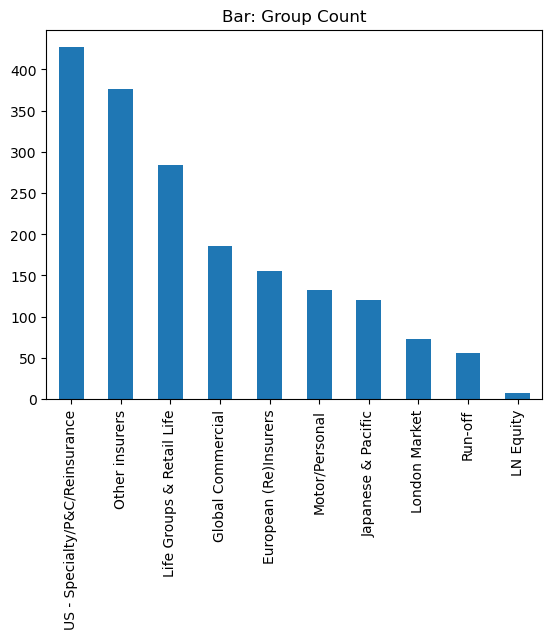

In [96]:
data['Group'].value_counts().plot(kind='bar', title ='Bar: Group Count')

In [55]:
fig = px.sunburst(
    data, path=['Group', 'company_name', 'ticker'], title = 'Sunburst: Companies by Groups '
)
fig.show()

## Sentiment Score by Date and Groups

In [91]:
df = data

fig = px.scatter(data, x="WA_sentiment", y="date",
	          color="Group",
                 log_x=True, size_max=60, title= 'Scatter: Sentiment Score by Date and Groups')
fig.show()

## Topics (cor score, topic clusters) (time series?)

,participants,file_name,date,idx,company_paticipants_yes,other_paticipants_yes,company_name,paraghrph,paraghrph_clean,paraghrph_noun,...,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20,topic_21,topic_22
0,Operator,20110202_LEGAL_-_GEN_GRP-_Guidance_Call_2011-2...,2011-02-02,1.0,1,1,LEGAL -,Hello. Welcome to the U.S. capital restructuri...,Hello Welcome to the US capital restructuring ...,capital restructuring program call today instr...,...,0.027701,0.024094,0.023219,0.005071,0.010126,0.025779,0.221528,0.011546,0.221971,0.013312
1,Luigi Lubelli,20110202 _Mapfre_SA_Earnings_Call_SD0000000027...,2011-02-02,325.0,1,0,Mapfre SA,"Then the -- probably on your third question, t...",Then the -- probably on your third question th...,question volatility realization gain figure fo...,...,0.127076,0.013323,0.012839,0.002804,0.005600,0.461289,0.010739,0.006385,0.010984,0.007361
2,Nigel Wilson,20110202_LEGAL_-_GEN_GRP-_Guidance_Call_2011-2...,2011-02-02,5.0,1,0,LEGAL -,"Thank you. Good afternoon, ladies and gentleme...",Thank you Good afternoon ladies and gentlemen ...,afternoon lady gentleman time call progress mo...,...,0.002690,0.002340,0.080767,0.000492,0.000983,0.002504,0.021514,0.001121,0.001929,0.001293
3,Nigel Wilson,20110202_LEGAL_-_GEN_GRP-_Guidance_Call_2011-2...,2011-02-02,128.0,1,0,LEGAL -,"Thanks, Chris. So in summary, a relatively sma...",Thanks So in summary a relatively small but i...,thank summary transaction material benefit com...,...,0.076068,0.007975,0.208383,0.001678,0.003352,0.008533,0.207126,0.003822,0.073474,0.004406
4,Nigel Wilson,20110202_LEGAL_-_GEN_GRP-_Guidance_Call_2011-2...,2011-02-02,148.0,1,0,LEGAL -,Yes. We envisage that perhaps we'll be able to...,Yes We envisage that perhaps we'll be able to ...,type transaction month financing way transacti...,...,0.019727,0.017159,0.448322,0.003611,0.007211,0.018358,0.013830,0.008223,0.014146,0.009480
